# DSPT7 Unit 2 Build Week Project:

## Predicting the frequency of the shape of reported UFO's in North America

* Source for my original dataset: [UFO Sightings from Kaggle]('https://www.kaggle.com/NUFORC/ufo-sightings?select=scrubbed.csv')  
* Based on data from: [National UFO Reporting Center (NUFORC)]('http://www.nuforc.org/')
  

## Start Code:

In [1]:
%%capture
import sys

# If you're on Colab:
# if 'google.colab' in sys.modules:
#     DATA_PATH = 'https://www.kaggle.com/NUFORC/ufo-sightings?select=scrubbed.csv'
#     !pip install category_encoders==2.*
#     !pip install pandas-profiling==2.*
    
# If you're working locally (I am working locally):
# else:
DATA_PATH = '../data/'
#     !pip install category_encoders==2.*
#     !pip install pandas-profiling==2.*
#     !pip install plotly==4.9.0

## Imports:

In [2]:
# Imports:
import pandas as pd
import pandas_profiling
from pandas_profiling import ProfileReport
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import IPython
from IPython.display import HTML
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
import plotly as py
from plotly.graph_objs import *
import plotly.express as px
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')
import category_encoders as ce
from sklearn import metrics
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score, plot_confusion_matrix, classification_report
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.inspection import permutation_importance
import eli5
from eli5.sklearn import PermutationImportance
from sklearn.compose import ColumnTransformer
from pdpbox import pdp
from pdpbox.pdp import pdp_isolate, pdp_plot, pdp_interact, pdp_interact_plot

## Read in my data:

In [3]:
# Read in my data:
data = 'https://raw.githubusercontent.com/jmmiddour/Projects/master/UFOs/ufo_sightings_scrubbed.csv'
ufos = pd.read_csv(data)

# Look at the first 5 rows:
ufos.head()

,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude
0,10/10/1949 20:30,san marcos,tx,us,cylinder,2700,45 minutes,This event took place in early fall around 194...,4/27/2004,29.8830556,-97.941111
1,10/10/1949 21:00,lackland afb,tx,NaN,light,7200,1-2 hrs,1949 Lackland AFB&#44 TX. Lights racing acros...,12/16/2005,29.38421,-98.581082
2,10/10/1955 17:00,chester (uk/england),NaN,gb,circle,20,20 seconds,Green/Orange circular disc over Chester&#44 En...,1/21/2008,53.2,-2.916667
3,10/10/1956 21:00,edna,tx,us,circle,20,1/2 hour,My older brother and twin sister were leaving ...,1/17/2004,28.9783333,-96.645833
4,10/10/1960 20:00,kaneohe,hi,us,light,900,15 minutes,AS a Marine 1st Lt. flying an FJ4B fighter/att...,1/22/2004,21.4180556,-157.803611


## Pandas Profile:

In [4]:
# # Look at the profile for this dataset:
# profile = ProfileReport(ufos, title='UFO Sightings (Original Data Set) 1906-2014', 
#                         html={'style': {'full_width':True}}, plot={'histogram': {'bins': 50}}, explorative=True)
# # profile.to_notebook_iframe()
# profile

# Commentting this out to reduce the size of my notebook. 
#   You can uncomment it if you would like to view the profile report.

In [5]:
# # Turn profile report into a html file to add to blog post:
# profile.to_file('UFO_pd_profile_report.html')

## Target Feature:

In [6]:
# Reduce the dimensionality of my target feature by group like variables into new classes:
ufos['shape_class'] = ufos['shape']
ufos['shape_class'] = ufos['shape_class'].replace(['other', 'unknown', np.nan], 'Other')
ufos['shape_class'] = ufos['shape_class'].replace(['circle', 'sphere', 'disk', 'round', 'oval'], 'Circular')
ufos['shape_class'] = ufos['shape_class'].replace(['triangle', 'hexagon', 'delta', 'chevron', 'rectangle', 
                                                   'diamond'], 'Geometric')
ufos['shape_class'] = ufos['shape_class'].replace(['pyramid', 'cylinder', 'egg', 'cone', 'dome', 
                                                   'cigar', 'cross', 'crescent', 'teardrop'], 'Non-Geometric')
ufos['shape_class'] = ufos['shape_class'].replace(['formation', 'changed', 'changing'], 'Multiple')
ufos['shape_class'] = ufos['shape_class'].replace(['light', 'fireball', 'flash', 'flare'], 'Type of Light')

# Check my work:
ufos['shape_class'].value_counts(normalize=True)

Type of Light    0.300030
Circular         0.273154
Other            0.163882
Geometric        0.140666
Non-Geometric    0.067246
Multiple         0.055022
Name: shape_class, dtype: float64

## Clean and explore my data:

### Dates and Times:

In [7]:
# Look at the length of a value that is the length it should be for formatting:
len(ufos['datetime'][0])

16

In [8]:
# Create a new column with length values of datetime values:
ufos['dt_len'] = ufos['datetime'].str.len()
ufos.head(3)

,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude,shape_class,dt_len
0,10/10/1949 20:30,san marcos,tx,us,cylinder,2700,45 minutes,This event took place in early fall around 194...,4/27/2004,29.8830556,-97.941111,Non-Geometric,16
1,10/10/1949 21:00,lackland afb,tx,NaN,light,7200,1-2 hrs,1949 Lackland AFB&#44 TX. Lights racing acros...,12/16/2005,29.38421,-98.581082,Type of Light,16
2,10/10/1955 17:00,chester (uk/england),NaN,gb,circle,20,20 seconds,Green/Orange circular disc over Chester&#44 En...,1/21/2008,53.2,-2.916667,Circular,16


In [9]:
# Look at the value counts of the new column and shape of dataframe 
#   before dropping rows with strange time formatting:
print('Datetime Length Frequencies before removing rows:\n\n', ufos['dt_len'].value_counts(), '\n')
print('Number of Observations before removing rows =', ufos.shape[0], '\n')

# Drop all rows with strange time (length more than 16):
ufos = ufos.drop(ufos.loc[ufos['dt_len'] >= 17].index)

# Check my work by looking at the new value counts and shape:
print('Datetime Length Frequencies after removing rows:\n\n', ufos['dt_len'].value_counts(), '\n')
print('Number of Observations after removing rows =', ufos.shape[0])

Datetime Length Frequencies before removing rows:

 15    38698
14    25611
16    10831
13     4498
22      380
21      193
23      120
20        1
Name: dt_len, dtype: int64 

Number of Observations before removing rows = 80332 

Datetime Length Frequencies after removing rows:

 15    38698
14    25611
16    10831
13     4498
Name: dt_len, dtype: int64 

Number of Observations after removing rows = 79638


In [10]:
# Need to change datetime feature to datetime data type:
ufos['datetime'] = pd.to_datetime(ufos['datetime'], infer_datetime_format=True)

# Check my work by looking at the data type now:
ufos['datetime'].dtypes

dtype('<M8[ns]')

In [11]:
# Break down the date of the sighting:
ufos['year'] = ufos['datetime'].dt.year
ufos['month'] = ufos['datetime'].dt.month
ufos['hour'] = ufos['datetime'].dt.hour
ufos['day'] = ufos['datetime'].dt.day
ufos['dow'] = ufos['datetime'].dt.weekday

# Change the dow to the name of the day for easier readability for right now:
ufos['dow'] = ufos['dow'].replace(range(0, 7), ['Mon', 'Tue', 'Wed', 'Thr', 'Fri', 'Sat', 'Sun'])

# Drop the datetime + dt_len, no longer need, and date posted + durations (hours/min), is not usable for me:
ufos.drop(columns=['datetime', 'dt_len', 'date posted', 'duration (hours/min)'], inplace=True)

# Check my work:
ufos.head()

,city,state,country,shape,duration (seconds),comments,latitude,longitude,shape_class,year,month,hour,day,dow
0,san marcos,tx,us,cylinder,2700,This event took place in early fall around 194...,29.8830556,-97.941111,Non-Geometric,1949,10,20,10,Mon
1,lackland afb,tx,NaN,light,7200,1949 Lackland AFB&#44 TX. Lights racing acros...,29.38421,-98.581082,Type of Light,1949,10,21,10,Mon
2,chester (uk/england),NaN,gb,circle,20,Green/Orange circular disc over Chester&#44 En...,53.2,-2.916667,Circular,1955,10,17,10,Mon
3,edna,tx,us,circle,20,My older brother and twin sister were leaving ...,28.9783333,-96.645833,Circular,1956,10,21,10,Wed
4,kaneohe,hi,us,light,900,AS a Marine 1st Lt. flying an FJ4B fighter/att...,21.4180556,-157.803611,Type of Light,1960,10,20,10,Mon


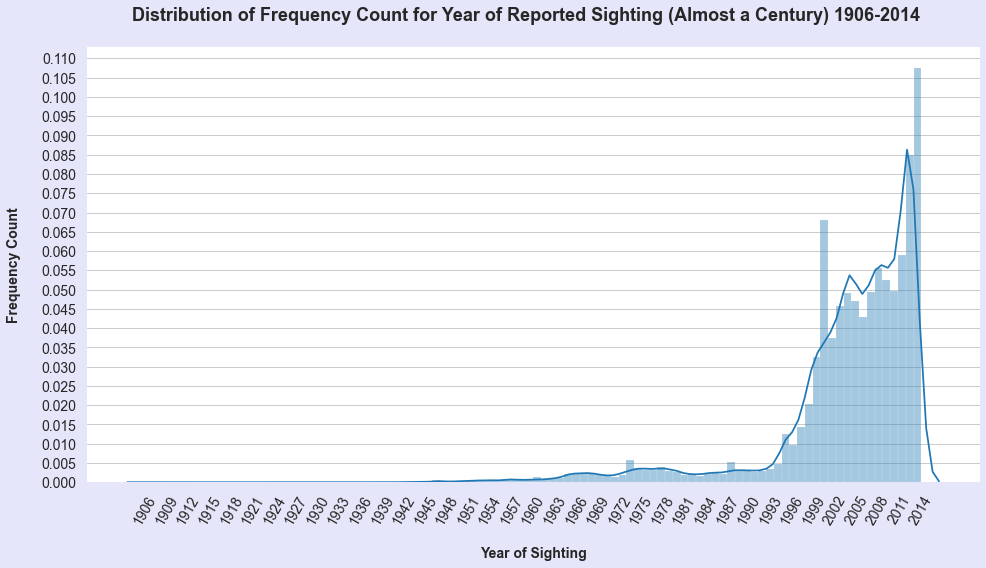

In [12]:
# Look at a distribution plot of year:
plt.figure(figsize=(16, 8), facecolor='lavender')
sns.distplot(ufos.year, bins=100)
plt.title(f'Distribution of Frequency Count for Year of Reported Sighting (Almost a Century) 1906-2014   \n', size=18, weight='bold')
plt.xlabel(f'\nYear of Sighting', size=14, weight='bold')
plt.ylabel(f'Frequency Count\n', size=14, weight='bold')
plt.xticks(np.arange(1906, 2016, step=3), rotation=60, size=14, )
plt.yticks(np.arange(-0.00, 0.115, step=0.005), size=14)
plt.grid(axis='y');

In [13]:
# Drop all rows prior to 1994 due to lack of data:
ufos.drop(ufos[ufos['year'] <= 1993].index, inplace=True)

# Reset the index and rename old index numbers:
ufos = ufos.reset_index().rename(columns={'index':'Id'})

# Check my work:
ufos['year'].value_counts(normalize=True).sort_index(ascending=False)

2014    0.031087
2013    0.096520
2012    0.100882
2011    0.070085
2010    0.058779
2009    0.062230
2008    0.065943
2007    0.058572
2006    0.050828
2005    0.055756
2004    0.058254
2003    0.054320
2002    0.044326
2001    0.042918
2000    0.037990
1999    0.038486
1998    0.024006
1997    0.017145
1996    0.011402
1995    0.014715
1994    0.005756
Name: year, dtype: float64

In [14]:
# Look at the first 2 rows to make sure the column rename worked:
ufos.head(2)

,Id,city,state,country,shape,duration (seconds),comments,latitude,longitude,shape_class,year,month,hour,day,dow
0,58,mercedies,tx,NaN,cigar,3600,ufo chased by fighter jet over Rio Grande Vall...,26.149798,-97.913611,Non-Geometric,1994,10,15,10,Mon
1,59,burnt hills,ny,us,rectangle,120,Giant rectangular craft (resembling an upside-...,42.9097222,-73.895556,Geometric,1994,10,18,10,Mon


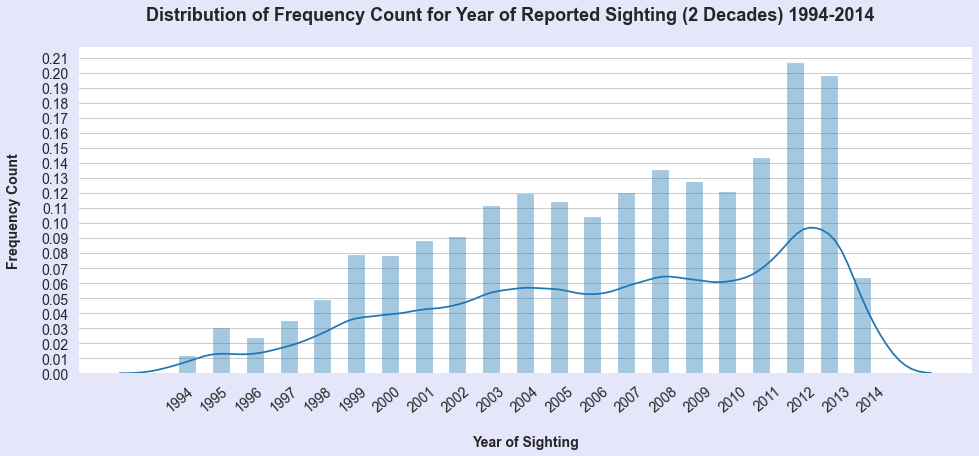

In [15]:
# Look at a distribution plot of year:
plt.figure(figsize=(16, 6), facecolor='lavender')
sns.distplot(ufos.year, bins=41)
plt.title(f'Distribution of Frequency Count for Year of Reported Sighting (2 Decades) 1994-2014      \n', 
          size=18, weight='bold')
plt.xlabel(f'\nYear of Sighting', size=14, weight='bold')
plt.ylabel(f'Frequency Count\n', size=14, weight='bold')
plt.xticks(np.arange(1994, 2015, step=1), rotation=40, size=14, )
plt.yticks(np.arange(0, 0.22, step=0.01), size=14)
plt.grid(axis='y');

In [16]:
# Look at the shape of my new dataset with reduction in years:
ufos.shape

(72441, 15)

In [17]:
# Find out why durations in secs is not supported in the profile:
print(ufos['duration (seconds)'].dtypes)

# Look at the value counts:
ufos['duration (seconds)'].value_counts()

object


300       6218
120       5175
600       4531
60        4343
180       3755
          ... 
1980.0       1
300.13       1
4140         1
425          1
3240         1
Name: duration (seconds), Length: 667, dtype: int64

In [18]:
# Change column names - replace spaces with underscores and removing () also: 
ufos = ufos.rename(columns={'duration (seconds)': 'durations_in_secs'})

In [19]:
# Need to replace values first that have typos:
ufos['durations_in_secs'].replace(['2`', '8`', '0.5`'], [2, 8, 0.5], inplace=True)

# Format the values to floats and all have 1 decimal place:
ufos['durations_in_secs'] = ufos['durations_in_secs'].astype(float).round(decimals=1)

# Check my work
print(ufos['durations_in_secs'].dtypes)
ufos.head(3)

float64


,Id,city,state,country,shape,durations_in_secs,comments,latitude,longitude,shape_class,year,month,hour,day,dow
0,58,mercedies,tx,NaN,cigar,3600.0,ufo chased by fighter jet over Rio Grande Vall...,26.149798,-97.913611,Non-Geometric,1994,10,15,10,Mon
1,59,burnt hills,ny,us,rectangle,120.0,Giant rectangular craft (resembling an upside-...,42.9097222,-73.895556,Geometric,1994,10,18,10,Mon
2,60,pinebergen,ar,us,light,5.0,Round&#44 bright&#44 low flying object silentl...,34.1027778,-91.992222,Type of Light,1994,10,22,10,Mon


In [20]:
# Remove outliners in duration in secs:
ufos.drop(ufos[ufos['durations_in_secs'] >= 3000000].index, inplace=True)

# Check my work:
ufos['durations_in_secs'].value_counts(normalize=True).sort_index(ascending=False)

2631600.0    0.000083
2102400.0    0.000028
1814400.0    0.000069
1209600.0    0.000083
1080000.0    0.000014
               ...   
0.4          0.000069
0.3          0.000083
0.2          0.000055
0.1          0.000083
0.0          0.000166
Name: durations_in_secs, Length: 486, dtype: float64

### Handle NaN Values:

In [21]:
# Look for null values:
ufos.isnull().sum()

Id                      0
city                    0
state                5129
country              8407
shape                1764
durations_in_secs       0
comments               12
latitude                0
longitude               0
shape_class             0
year                    0
month                   0
hour                    0
day                     0
dow                     0
dtype: int64

In [22]:
# Replace all null values with 0 for right now, then will change it back to impute the values later:
ufos = ufos.replace(np.nan, 0)

# Check my work:
ufos.isnull().sum()

Id                   0
city                 0
state                0
country              0
shape                0
durations_in_secs    0
comments             0
latitude             0
longitude            0
shape_class          0
year                 0
month                0
hour                 0
day                  0
dow                  0
dtype: int64

## Apply re (Real Expression) to Comments and City Features:

In [23]:
# Look at the number of rows in comments and city:
print('Comments', ufos.comments.shape[0])
print('City', ufos.city.shape[0])

Comments 72427
City 72427


In [24]:
# Import new libraries:
import re
import string

# Create a function to do first clean on the comments column:
def clean_text1(text):
  '''
  Remove text in [ ], punctuation, and numbers, and make text lowercase 
  '''
  text = re.sub('[^a-zA-Z]',  ' ', str(text)) # Converts all values to strings with spaces
  text = re.sub('[&#*\d]', '', text)  # Removes text in [ ]
  text = re.sub('[%s]' % re.escape(string.punctuation), '', text) # Removes punctuation
  text = text.lower()  # Makes all text lowercase
  return text

In [25]:
# Test out my function on some of the comment values:
print (clean_text1('OBJECT SPEED APPX. 70 MPH'))
print (clean_text1('Five sightings of glowing red orange fireball object over Pittsburg&#44 CA'))
print (clean_text1('Round&#44 bright&#44 low flying object silentl'))

object speed appx     mph
five sightings of glowing red orange fireball object over pittsburg     ca
round     bright     low flying object silentl


In [26]:
# Loop through all values in column:
re1 = lambda x: clean_text1(x)

# Apply to comments column:
ufo_c1 = pd.DataFrame(ufos.comments.apply(re1))
ufo_c1.sample(10)

,comments
14596,i and the bridge of the uss abraham lincoln w...
17277,the object appeared cylinder shaped almost...
54640,solid bright white light
2919,as i was walking facing west i began to no...
24444,unblinking bright light in night sky that appe...
24015,star like abject moving randomly across the sky
68357,a object that flew extremely slow triangul...
70700,i went outside smoking cigaret and i saw yello...
52783,saucer craft seen hovering ft above ground ...
66655,large object over route


In [27]:
# Import to create a document-term matrix:
from sklearn.feature_extraction.text import CountVectorizer

# Show max columns:
pd.set_option('display.max_columns', None)

# Use Count Vectorizer to create a Document Term Matrix with at least 100 value counts on train set:
cv1 = CountVectorizer(stop_words='english', min_df=100)
ufo_cv = cv1.fit_transform(ufo_c1.comments)
ufo_c = pd.DataFrame(ufo_cv.toarray(), columns=cv1.get_feature_names())

# Check my work:
print (ufo_c.shape)
ufo_c.head(1)

(72427, 765)


,accross,afternoon,air,aircraft,airplane,airport,alien,altitude,amazing,amber,amp,angeles,angle,apart,appear,appeared,appearing,appears,approx,approximately,april,aprox,arc,area,arizona,atmosphere,august,away,az,backyard,ball,balloon,balls,base,bay,beach,beam,beams,bedroom,began,believe,big,bigger,binoculars,bizarre,black,blinking,blue,bluish,body,boomerang,bright,brighter,brightly,brightness,brilliant,broad,brother,building,burning,ca,california,called,came,camera,canada,canadian,car,carolina,caught,center,central,change,changed,changes,changing,chased,chasing,chevron,chicago,cigar,cigarette,circle,circles,circling,circular,city,clear,clearly,close,closer,cloud,clouds,cloudy,cluster,coast,color,colorado,colored,colors,colour,come,comet,coming,commercial,completely,cone,constant,contrail,corner,corners,county,couple,course,cover,craft,crafts,cross,crossed,crossing,ct,cylinder,cylindrical,dancing,dark,darting,date,daughter,day,daylight,daytime,deck,deg,degree,degrees,denver,descending,desert,diamond,did,didn,diego,different,dim,dimmed,direction,directions,directly,disapeared,disappear,disappeared,disappearing,disappears,disc,disk,dissapeared,dissappeared,distance,distant,distinct,dog,doing,door,dot,dots,downtown,downward,driving,dropped,dropping,dull,duration,dusk,early,earth,east,eastern,edge,egg,emitted,emitting,encounter,end,england,entire,erratic,erratically,eve,evening,event,extreme,extremely,eye,eyes,facing,fade,faded,fades,fading,faint,fall,falling,falls,family,far,fast,faster,feet,fell,field,fiery,fighter,fireball,fireballs,fireworks,fl,flame,flaming,flare,flash,flashed,flashes,flashing,flat,flew,flickering,flies,flight,floated,floating,florida,fly,flying,follow,followed,following,football,form,formation,formations,formed,forming,fort,forth,freeway,friend,friends,ft,ga,georgia,getting,giant,girlfriend,gliding,glow,glowing,going,gold,golden,gone,good,got,gray,great,green,greenish,grey,ground,group,gulf,half,hanging,happened,having,haze,hbccufo,head,headed,heading,heard,helicopter,helicopters,high,highway,hill,hills,hoax,home,horizon,horizontal,horizontally,hot,hour,hours,house,houston,hover,hovered,hovering,hovers,hrs,huge,humming,husband,hwy,il,illinois,illuminated,incredible,indiana,inside,instantly,intense,interstate,island,iss,jersey,jet,jets,july,june,jupiter,just,kansas,kept,kind,know,la,lake,landing,large,larger,las,lasted,lasting,late,later,launch,leaving,left,length,level,light,lighted,lighting,lightning,lights,like,line,lines,lit,lite,little,live,local,location,long,look,looked,looking,looks,los,lot,loud,low,lower,luminous,ma,make,making,man,march,massive,maybe,metalic,metallic,meteor,mexico,mi,michigan,mid,middle,midnight,mile,miles,military,min,mins,minute,minutes,missile,missouri,mn,mo,moon,morning,mother,motion,motionless,mountain,mountains,moved,movement,movements,moves,moving,mph,mt,multi,multiple,mysterious,nc,nd,ne,near,neighborhood,neon,new,night,nights,nj,noise,non,normal,north,northeast,northern,northwest,note,notice,noticed,november,nuforc,nw,ny,obj,object,objects,observed,ocean,october,odd,ohio,old,ontario,orange,orangish,orb,orbs,oregon,outside,oval,overhead,pa,pace,parallel,park,pass,passed,passing,past,path,pattern,patterns,pd,people,perfect,perfectly,period,phoenix,phone,photo,photos,picture,pictures,pink,place,plane,planes,planet,pm,point,points,police,porch,portland,position,possible,possibly,power,probably,pulsating,pulsing,purple,quick,quickly,quiet,quite,quot,random,range,rapid,rapidly,rate,rd,real,really,reappeared,rectangle,rectangular,red,reddish,redish,reflective,report,reported,reports,repts,right,ring,rising,river,road,rocket,room,rose,rotating,round,route,row,rural,said,san,santa,sat,satellite,satellites,saucer,saw,sc,school,se,sea,seattle,sec,second,seconds,seeing,seen,sees,separate,september,series,set,sets,seven,shape,shaped,shapes,sharp,shining,shiny,ship,shoot,shooting,shoots,short,shot,shuttle,sight,sighted,sighting,sightings,silent,silently,silver,silvery,similar,single,siriu

In [28]:
# The features I will keep:
ufo_c = ufo_c[['amber', 'black', 'blue', 'bluish', 'changed', 'changing', 'clear', 'close', 'closer', 'colored', 
                   'colors', 'colour', 'dark', 'darting', 'disappear', 'disappeared', 'disappearing', 'disappears', 
                   'dissapeared', 'dissappeared', 'downward', 'dropped', 'dropping', 'dull', 'east', 'eastern', 
                   'erratic', 'erratically', 'faded', 'fall', 'falling', 'falls', 'fast', 'faster', 'fell', 'flew', 'floating', 
                   'flies', 'floated', 'floating', 'fly', 'flying', 'follow', 'followed', 'following', 'going', 'gold', 'golden', 
                   'gray', 'green', 'greenish', 'grey', 'high', 'hoax', 'horizon', 'hover', 'hovered', 'hovering', 'hovers',
                   'huge', 'humming', 'instantly', 'large', 'larger', 'long', 'low', 'lower', 'metalic', 'metallic', 'motion', 
                   'motionless', 'moved', 'movement', 'movements', 'moves', 'moving', 'neon', 'near', 'noise', 
                   'north', 'northeast', 'northern', 'northwest', 'orange', 'orangish', 'overhead', 'pulsating', 
                   'pulsing', 'purple', 'quick', 'quickly', 'quiet', 'rapid', 'rapidly', 'reappeared', 'red', 'reddish', 
                   'redish', 'reflective', 'rising', 'rose', 'rotating', 'silent', 'silently', 'silver', 'silvery', 'sitting', 
                   'slow', 'slowly', 'small', 'smaller', 'solid', 'sound', 'sounds', 'south', 'southeast', 'southern', 
                   'southwest', 'sped', 'speed', 'speeding', 'speeds', 'stationary', 'stayed', 'steady', 'stop', 'stopped', 
                   'stopping', 'stops', 'straight', 'sudden', 'suddenly', 'trail', 'traveling', 'translucent', 'transparent', 
                   'turned', 'turning', 'turns', 'upward', 'upwards', 'vanish', 'vanished', 'vanishes', 'vanishing', 
                   'west', 'western', 'white', 'yellow', 'yellowish', 'zag', 'zagging', 'zig']]

# Check my work:
print (ufo_c.shape)
ufo_c.head(1)

(72427, 153)


,amber,black,blue,bluish,changed,changing,clear,close,closer,colored,colors,colour,dark,darting,disappear,disappeared,disappearing,disappears,dissapeared,dissappeared,downward,dropped,dropping,dull,east,eastern,erratic,erratically,faded,fall,falling,falls,fast,faster,fell,flew,floating,flies,floated,floating,fly,flying,follow,followed,following,going,gold,golden,gray,green,greenish,grey,high,hoax,horizon,hover,hovered,hovering,hovers,huge,humming,instantly,large,larger,long,low,lower,metalic,metallic,motion,motionless,moved,movement,movements,moves,moving,neon,near,noise,north,northeast,northern,northwest,orange,orangish,overhead,pulsating,pulsing,purple,quick,quickly,quiet,rapid,rapidly,reappeared,red,reddish,redish,reflective,rising,rose,rotating,silent,silently,silver,silvery,sitting,slow,slowly,small,smaller,solid,sound,sounds,south,southeast,southern,southwest,sped,speed,speeding,speeds,stationary,stayed,steady,stop,stopped,stopping,stops,straight,sudden,suddenly,trail,traveling,translucent,transparent,turned,turning,turns,upward,upwards,vanish,vanished,vanishes,vanishing,west,western,white,yellow,yellowish,zag,zagging,zig
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [29]:
# To prevent SettingWithCopyWarning:
ufos = ufos.copy()
ufo_c = ufo_c.copy()

# Concatenate the dataframes:
ufo = pd.concat([ufos, ufo_c], axis=1)

# Check my work:
print (ufo.shape)
ufo.head(2)

(72441, 168)


,Id,city,state,country,shape,durations_in_secs,comments,latitude,longitude,shape_class,year,month,hour,day,dow,amber,black,blue,bluish,changed,changing,clear,close,closer,colored,colors,colour,dark,darting,disappear,disappeared,disappearing,disappears,dissapeared,dissappeared,downward,dropped,dropping,dull,east,eastern,erratic,erratically,faded,fall,falling,falls,fast,faster,fell,flew,floating,flies,floated,floating,fly,flying,follow,followed,following,going,gold,golden,gray,green,greenish,grey,high,hoax,horizon,hover,hovered,hovering,hovers,huge,humming,instantly,large,larger,long,low,lower,metalic,metallic,motion,motionless,moved,movement,movements,moves,moving,neon,near,noise,north,northeast,northern,northwest,orange,orangish,overhead,pulsating,pulsing,purple,quick,quickly,quiet,rapid,rapidly,reappeared,red,reddish,redish,reflective,rising,rose,rotating,silent,silently,silver,silvery,sitting,slow,slowly,small,smaller,solid,sound,sounds,south,southeast,southern,southwest,sped,speed,speeding,speeds,stationary,stayed,steady,stop,stopped,stopping,stops,straight,sudden,suddenly,trail,traveling,translucent,transparent,turned,turning,turns,upward,upwards,vanish,vanished,vanishes,vanishing,west,western,white,yellow,yellowish,zag,zagging,zig
0,58.0,mercedies,tx,0,cigar,3600.0,ufo chased by fighter jet over Rio Grande Vall...,26.149798,-97.913611,Non-Geometric,1994.0,10.0,15.0,10.0,Mon,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,59.0,burnt hills,ny,us,rectangle,120.0,Giant rectangular craft (resembling an upside-...,42.9097222,-73.895556,Geometric,1994.0,10.0,18.0,10.0,Mon,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [30]:
# Prevent SettingWithCopyWarning:
ufo = ufo.copy()

# Combine some features:
ufo['color'] = ufo[['amber', 'black', 'blue', 'bluish', 'changed', 'changing', 'clear', 'colored', 'colors', 'colour', 
                    'dark', 'dull', 'faded', 'gold', 'golden', 'gray', 'green', 'greenish', 'grey', 'metalic', 'metallic', 
                    'neon', 'orange', 'orangish', 'purple', 'red', 'reddish', 'redish', 'reflective', 'silver', 'silvery', 
                    'solid', 'translucent', 'transparent', 'yellow', 'yellowish']].sum(axis=1)
ufo['movement'] = ufo[['darting', 'disappear', 'disappeared', 'disappearing', 'disappears', 'dissapeared', 
                       'dissappeared', 'downward', 'dropped', 'dropping', 'east', 'eastern', 'erratic', 'erratically', 
                       'fast', 'flew', 'floating', 'flies', 'floated', 'floating', 'fly', 'flying', 'follow', 'followed', 'following', 
                       'going', 'hover', 'hovered', 'hovering', 'hovers', 'instantly', 'motion', 'motionless', 'moved', 
                       'movement', 'movements', 'moves', 'moving', 'north', 'northeast', 'northern', 'northwest', 
                       'straight', 'quick', 'quickly', 'rapid', 'rapidly', 'reappeared', 'rising', 'rose', 'rotating', 'sitting', 
                       'slow', 'slowly', 'south', 'southeast', 'southern', 'southwest', 'sped', 'speed', 'speeding', 
                       'speeds', 'stationary', 'stayed', 'steady', 'stop', 'stopped', 'stops', 'straight', 'sudden', 
                       'suddenly', 'trail', 'traveling', 'turned', 'turning', 'turns', 'upward', 'upwards', 'vanish', 
                       'vanished', 'vanishes', 'vanishing', 'west', 'western', 'zag', 'zagging', 'zig']].sum(axis=1)
ufo['elevation'] = ufo[['close', 'closer', 'fall', 'falling', 'falls', 'high', 'horizon', 'low', 'lower', 'near', 
                        'overhead']].sum(axis=1)
ufo['sound'] = ufo[['humming', 'noise', 'pulsating', 'pulsing', 'quiet', 'silent', 'silently', 'sound', 
                    'sounds']].sum(axis=1)

# Drop some columns:large	larger	long	small	smaller	
ufo = ufo.drop(columns=['comments', 'amber', 'black', 'blue', 'bluish', 'changed', 'changing', 'clear', 'close', 
                        'closer', 'colored', 'colors', 'colour', 'dark', 'darting', 'disappear', 'disappeared', 'disappearing', 
                        'disappears', 'dissapeared', 'dissappeared', 'downward', 'dropped', 'dropping', 'dull', 'east', 
                        'eastern', 'erratic', 'erratically', 'faded', 'fall', 'falling', 'falls', 'fast', 'faster', 'fell', 'flew', 'floating', 
                        'flies', 'floated', 'floating', 'fly', 'flying', 'follow', 'followed', 'following', 'going', 'gold', 
                        'golden', 'gray', 'green', 'greenish', 'grey', 'high', 'horizon', 'hover', 'hovered', 'hovering', 
                        'hovers', 'huge', 'humming', 'instantly', 'large', 'larger', 'long', 'low', 'lower', 'metalic', 
                        'metallic', 'motion', 'motionless', 'moved', 'movements', 'moves', 'moving', 'neon', 'near', 
                        'noise', 'north', 'northeast', 'northern', 'northwest', 'orange', 'orangish', 'overhead', 
                        'pulsating', 'pulsing', 'purple', 'quick', 'quickly', 'quiet', 'rapid', 'rapidly', 'reappeared', 
                        'red', 'reddish', 'redish', 'reflective', 'rising', 'rose', 'rotating', 'silent', 'silently', 'silver', 
                        'silvery', 'sitting', 'slow', 'slowly', 'small', 'smaller', 'solid', 'sounds', 'south', 'southeast', 
                        'southern', 'southwest', 'sped', 'speed', 'speeding', 'speeds', 'stationary', 'stayed', 'steady', 
                        'stop', 'stopped', 'stopping', 'stops', 'straight', 'sudden', 'suddenly', 'trail', 'traveling', 
                        'translucent', 'transparent', 'turned', 'turning', 'turns', 'upward', 'upwards', 'vanish', 
                        'vanished', 'vanishes', 'vanishing', 'west', 'western', 'white', 'yellow', 'yellowish', 'zag', 
                        'zagging', 'zig'])

# Turn features from comment feature into binary:
ufo.loc[(ufo['color'] != 0), 'color'] = 1
ufo.loc[(ufo['sound'] != 0), 'sound'] = 1
ufo.loc[(ufo['movement'] != 0), 'movement'] = 1
ufo.loc[(ufo['elevation'] != 0), 'elevation'] = 1
ufo.loc[(ufo['hoax'] != 0), 'hoax'] = 1

# Rearrange features:
ufo = ufo[['Id', 'year', 'month', 'day', 'dow', 'hour', 'durations_in_secs', 'city', 'state', 'country', 'latitude', 
           'longitude', 'color', 'movement', 'elevation', 'sound', 'hoax', 'shape_class']]

# Check my work:
print(ufo.shape)
ufo.head(2)

(72441, 18)


,Id,year,month,day,dow,hour,durations_in_secs,city,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58.0,1994.0,10.0,10.0,Mon,15.0,3600.0,mercedies,tx,0,26.149798,-97.913611,0.0,0.0,0.0,0.0,0.0,Non-Geometric
1,59.0,1994.0,10.0,10.0,Mon,18.0,120.0,burnt hills,ny,us,42.9097222,-73.895556,0.0,0.0,1.0,0.0,0.0,Geometric


In [31]:
# Need to split the city column because the country is listed in some of them:
city_split = ufo.city.str.split(' ', expand=True)

# Check my work:
city_split.head()

,0,1,2,3,4,5,6,7,8,9,10,11
0,mercedies,None,None,None,None,None,None,None,None,None,None,None
1,burnt,hills,None,None,None,None,None,None,None,None,None,None
2,pinebergen,None,None,None,None,None,None,None,None,None,None,None
3,toronto,(greater,toronto,area),(canada),None,None,None,None,None,None,None
4,milwaukee,None,None,None,None,None,None,None,None,None,None,None


In [32]:
# Look at the value counts for each column:
for col in city_split:
    print(f'{col}\n', city_split[col].value_counts(), '\n')

0
 san                    1248
new                     913
st.                     601
seattle                 546
north                   531
                       ... 
dungarvan                 1
lakehills                 1
hilltop                   1
woodbury/middlebury       1
arbuckle/college          1
Name: 0, Length: 11296, dtype: int64 

1
 (canada)        2478
(uk/england)    1372
city            1310
beach           1093
park             602
                ... 
(20-25             1
(ga)/cedar         1
franklin           1
23                 1
kendallville       1
Name: 1, Length: 3152, dtype: int64 

2
 city            676
(canada)        605
(uk/england)    291
beach           267
of)             215
               ... 
to;               1
hill/bowling      1
rapids            1
pleasant          1
lapu-lapu         1
Name: 2, Length: 1637, dtype: int64 

3
 (brooklyn)      126
of)             109
(uk/england)    101
(canada)        101
miles            66
              

In [33]:
# To prevent SettingWithCopyWarning:
ufo = ufo.copy()
city_split = city_split.copy()

# Drop column 11 first, no useful information:
city_split.drop(columns=11, inplace=True)

# Concatenate the dataframes:
ufo = pd.concat([ufo, city_split], axis=1)

# Check my work:
print (ufo.shape)
ufo.head()

(72441, 29)


,Id,year,month,day,dow,hour,durations_in_secs,city,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class,0,1,2,3,4,5,6,7,8,9,10
0,58.0,1994.0,10.0,10.0,Mon,15.0,3600.0,mercedies,tx,0,26.149798,-97.913611,0.0,0.0,0.0,0.0,0.0,Non-Geometric,mercedies,None,None,None,None,None,None,None,None,None,None
1,59.0,1994.0,10.0,10.0,Mon,18.0,120.0,burnt hills,ny,us,42.9097222,-73.895556,0.0,0.0,1.0,0.0,0.0,Geometric,burnt,hills,None,None,None,None,None,None,None,None,None
2,60.0,1994.0,10.0,10.0,Mon,22.0,5.0,pinebergen,ar,us,34.1027778,-91.992222,0.0,1.0,1.0,1.0,0.0,Type of Light,pinebergen,None,None,None,None,None,None,None,None,None,None
3,61.0,1994.0,10.0,10.0,Mon,23.0,3600.0,toronto (greater toronto area) (canada),on,ca,43.666667,-79.416667,0.0,0.0,0.0,0.0,0.0,Circular,toronto,(greater,toronto,area),(canada),None,None,None,None,None,None
4,62.0,1995.0,10.0,10.0,Tue,19.0,120.0,milwaukee,wi,us,43.0388889,-87.906389,1.0,0.0,0.0,0.0,0.0,Other,milwaukee,None,None,None,None,None,None,None,None,None,None


In [34]:
# Rearrange the features:
ufo = ufo[['Id', 'year', 'month', 'dow', 'hour', 'durations_in_secs', 'city', 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 'state', 
           'country', 'latitude', 'longitude', 'color', 'movement', 'elevation', 'sound', 'hoax', 'shape_class']]

# Check my work:
ufo.head()

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58.0,1994.0,10.0,Mon,15.0,3600.0,mercedies,mercedies,None,None,None,None,None,None,None,None,None,None,tx,0,26.149798,-97.913611,0.0,0.0,0.0,0.0,0.0,Non-Geometric
1,59.0,1994.0,10.0,Mon,18.0,120.0,burnt hills,burnt,hills,None,None,None,None,None,None,None,None,None,ny,us,42.9097222,-73.895556,0.0,0.0,1.0,0.0,0.0,Geometric
2,60.0,1994.0,10.0,Mon,22.0,5.0,pinebergen,pinebergen,None,None,None,None,None,None,None,None,None,None,ar,us,34.1027778,-91.992222,0.0,1.0,1.0,1.0,0.0,Type of Light
3,61.0,1994.0,10.0,Mon,23.0,3600.0,toronto (greater toronto area) (canada),toronto,(greater,toronto,area),(canada),None,None,None,None,None,None,on,ca,43.666667,-79.416667,0.0,0.0,0.0,0.0,0.0,Circular
4,62.0,1995.0,10.0,Tue,19.0,120.0,milwaukee,milwaukee,None,None,None,None,None,None,None,None,None,None,wi,us,43.0388889,-87.906389,1.0,0.0,0.0,0.0,0.0,Other


### Locations:

In [35]:
# There is a mistype in one of the latitude values causing it to be an object data type.
# Need to remove the letter in the problem value:
ufo['latitude'] = ufo['latitude'].replace('33q.200088', '33.200088')

# Convert latitue to a float now that I replaced the problem value:
ufo['latitude'] = ufo['latitude'].astype(float)

# Check my work by checking the data type now:
ufo['latitude'].dtypes

dtype('float64')

In [36]:
# Capitalize first letter of each word in city:
ufo['city'] = ufo['city'].str.title()

# Capitalize state abbreviations:
ufo['state'] = ufo['state'].str.upper()

# Check my work:
ufo.head()

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58.0,1994.0,10.0,Mon,15.0,3600.0,Mercedies,mercedies,None,None,None,None,None,None,None,None,None,None,TX,0,26.149798,-97.913611,0.0,0.0,0.0,0.0,0.0,Non-Geometric
1,59.0,1994.0,10.0,Mon,18.0,120.0,Burnt Hills,burnt,hills,None,None,None,None,None,None,None,None,None,NY,us,42.909722,-73.895556,0.0,0.0,1.0,0.0,0.0,Geometric
2,60.0,1994.0,10.0,Mon,22.0,5.0,Pinebergen,pinebergen,None,None,None,None,None,None,None,None,None,None,AR,us,34.102778,-91.992222,0.0,1.0,1.0,1.0,0.0,Type of Light
3,61.0,1994.0,10.0,Mon,23.0,3600.0,Toronto (Greater Toronto Area) (Canada),toronto,(greater,toronto,area),(canada),None,None,None,None,None,None,ON,ca,43.666667,-79.416667,0.0,0.0,0.0,0.0,0.0,Circular
4,62.0,1995.0,10.0,Tue,19.0,120.0,Milwaukee,milwaukee,None,None,None,None,None,None,None,None,None,None,WI,us,43.038889,-87.906389,1.0,0.0,0.0,0.0,0.0,Other


In [37]:
# Change country values to names:
ufo['country'] = ufo['country'].replace(['us', 'ca', 'gb', 'au', 'de'], ['USA', 'Canada', 'UK', 
                                                                           'Australia', 'Germany'])

# Check my work:
ufo.country.value_counts()

USA          58976
0             8407
Canada        2744
UK            1733
Australia      483
Germany         84
Name: country, dtype: int64

In [38]:
# Replace None with 0:
ufo = ufo.replace(np.nan, 0)

# Check my work:
ufo.head()

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58.0,1994.0,10.0,Mon,15.0,3600.0,Mercedies,mercedies,0,0,0,0,0,0,0,0,0,0,TX,0,26.149798,-97.913611,0.0,0.0,0.0,0.0,0.0,Non-Geometric
1,59.0,1994.0,10.0,Mon,18.0,120.0,Burnt Hills,burnt,hills,0,0,0,0,0,0,0,0,0,NY,USA,42.909722,-73.895556,0.0,0.0,1.0,0.0,0.0,Geometric
2,60.0,1994.0,10.0,Mon,22.0,5.0,Pinebergen,pinebergen,0,0,0,0,0,0,0,0,0,0,AR,USA,34.102778,-91.992222,0.0,1.0,1.0,1.0,0.0,Type of Light
3,61.0,1994.0,10.0,Mon,23.0,3600.0,Toronto (Greater Toronto Area) (Canada),toronto,(greater,toronto,area),(canada),0,0,0,0,0,0,ON,Canada,43.666667,-79.416667,0.0,0.0,0.0,0.0,0.0,Circular
4,62.0,1995.0,10.0,Tue,19.0,120.0,Milwaukee,milwaukee,0,0,0,0,0,0,0,0,0,0,WI,USA,43.038889,-87.906389,1.0,0.0,0.0,0.0,0.0,Other


In [39]:
# Look at the number of rows where country is 0:
ufo[ufo['country'] == 0].shape[0]

8421

In [40]:
# Seems that most of the countries where a state is listed is in the US:
# Look at those first:
states = ufo[(ufo['country'] == 0) & (ufo['state'] != 0)]
print (states.shape)
states.sample(10)

(5574, 28)


,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
67589,75248.0,1999.0,9.0,Fri,5.0,5.0,Western North Carolina Mountains,western,north,carolina,mountains,0,0,0,0,0,0,0,NC,0,35.759573,-79.019300,1.0,0.0,0.0,0.0,0.0,Type of Light
54927,61047.0,2004.0,7.0,Sat,22.0,5.0,E. Falmouth,e.,falmouth,0,0,0,0,0,0,0,0,0,MA,0,41.578443,-70.558640,0.0,1.0,0.0,0.0,0.0,Circular
8830,9794.0,1999.0,11.0,Tue,19.0,5.0,London/St.Thomas (Canada),london/st.thomas,(canada),0,0,0,0,0,0,0,0,0,ON,0,42.998851,-81.289237,0.0,1.0,0.0,0.0,0.0,Type of Light
70638,78432.0,2004.0,9.0,Wed,22.0,3.0,Santa Rosa / Novato,santa,rosa,/,novato,0,0,0,0,0,0,0,CA,0,38.107420,-122.569703,1.0,0.0,0.0,0.0,0.0,Circular
31930,34140.0,2000.0,3.0,Thr,3.0,900.0,Hooker/Guymon (Between),hooker/guymon,(between),0,0,0,0,0,0,0,0,0,OK,0,36.860016,-101.208034,0.0,0.0,0.0,0.0,0.0,Circular
67100,74738.0,1999.0,9.0,Wed,7.0,300.0,Smithville/Sink Creek,smithville/sink,creek,0,0,0,0,0,0,0,0,0,TN,0,35.856928,-85.801057,0.0,1.0,1.0,0.0,0.0,Type of Light
32778,35020.0,2009.0,3.0,Fri,19.0,120.0,Westly,westly,0,0,0,0,0,0,0,0,0,0,CA,0,37.549376,-121.199104,0.0,1.0,0.0,0.0,0.0,Geometric
9140,10114.0,1998.0,11.0,Tue,4.0,30.0,Joshua Tree National Park,joshua,tree,national,park,0,0,0,0,0,0,0,CA,0,33.873415,-115.900992,0.0,0.0,0.0,0.0,0.0,Type of Light
32800,35042.0,2011.0,3.0,Sun,16.0,5.0,Camp Pendleton,camp,pendleton,0,0,0,0,0,0,0,0,0,CA,0,33.317842,-117.320512,0.0,0.0,1.0,0.0,0.0,Type of Light
58911,65524.0,2011.0,8.0,Fri,21.0,1200.0,Paris Landing,paris,landing,0,0,0,0,0,0,0,0,0,TN,0,36.352339,-88.350492,1.0,0.0,0.0,0.0,0.0,Circular


In [41]:
# Change all values in coutry where state == val:
ufo.loc[(ufo['state'] == 'AK') & (ufo['country'] == 'USA'), 'country'] = 'Alaska'
ufo.loc[(ufo['state'] == 'AK') & (ufo['country'] == 0), 'country'] = 'Alaska'
ufo.loc[(ufo['state'] == 'HI') & (ufo['country'] == 'USA'), 'country'] = 'Hawaii'
ufo.loc[(ufo['state'] == 'HI') & (ufo['country'] == 0), 'country'] = 'Hawaii'
ufo.loc[(ufo['state'] == 'BC') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'NF') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'ON') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'AB') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'PE') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'PQ') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'MB') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'QC') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'NT') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'SK') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'NS') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'NB') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'YT') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'PR') & (ufo['country'] == 0), 'country'] = 'Puerto Rico'

# Check my work:
ufo['country'].value_counts(sort=False)

0               7778
Hawaii           313
Puerto Rico        3
Germany           84
Canada          3279
Alaska           300
USA            58468
Australia        483
UK              1733
Name: country, dtype: int64

In [42]:
# Need to do more cleaning on countries, going to do that in another notebook, need to save to a csv to do so:
ufo.to_csv('ufos_countries_to_clean.csv', index=False)

In [43]:
# I only want the North American Countries right for now:
# Change all countries not = to USA, Hawaii, Alaska, or Canada to other:
ufo['n_america'] = ufo['country']
include = ['USA', 'Canada', 'Alaska', 'Hawaii', 'Puerto Rico']
ufo[~ufo['n_america'].isin(include)] = 'Other'

# Check my work:
ufo['n_america'].value_counts()

USA            58468
Other          10078
Canada          3279
Hawaii           313
Alaska           300
Puerto Rico        3
Name: n_america, dtype: int64

In [44]:
# Look at the shape before dropping rows:
print('Before dropping "Other" countries =', ufo.shape)

# Drop all the 'Other' rows, do not need those because I am only looking at north american countries:
ufo_other = ufo[ufo['n_america'] == 'Other']
ufo.drop(ufo_other.index, inplace=True)

# Check my work:
print('After dropping "Other" countries =', ufo.shape)
ufo['n_america'].value_counts()

Before dropping "Other" countries = (72441, 29)
After dropping "Other" countries = (62363, 29)


USA            58468
Canada          3279
Hawaii           313
Alaska           300
Puerto Rico        3
Name: n_america, dtype: int64

### Drop Some Features:

In [45]:
# Look at the value counts for each column:
for col in ufo:
    print(f'{col}:\n', ufo[col].value_counts(), '\n')

Id:
 80331.0    1
25756.0    1
25786.0    1
25785.0    1
25784.0    1
          ..
53306.0    1
53305.0    1
53304.0    1
53302.0    1
59.0       1
Name: Id, Length: 62363, dtype: int64 

year:
 2012.0    6577
2013.0    6345
2011.0    4503
2008.0    4129
2009.0    3803
2010.0    3704
2007.0    3650
2004.0    3539
2005.0    3424
2003.0    3285
2006.0    3028
2002.0    2631
2001.0    2609
1999.0    2361
2000.0    2282
2014.0    2025
1998.0    1462
1997.0    1053
1995.0     932
1996.0     681
1994.0     340
Name: year, dtype: int64 

month:
 7.0     7127
8.0     6617
9.0     6064
10.0    5922
11.0    5545
6.0     5249
12.0    4567
1.0     4538
3.0     4424
4.0     4395
5.0     4099
2.0     3816
Name: month, dtype: int64 

dow:
 Sat    11117
Sun     9078
Fri     9017
Wed     8553
Thr     8519
Tue     8328
Mon     7751
Name: dow, dtype: int64 

hour:
 21.0    9295
22.0    8661
20.0    6849
23.0    6154
19.0    4864
0.0     3143
18.0    3138
1.0     2454
17.0    2010
2.0     1704
3.0     150

In [46]:
# Drop all the rows where hoax = 1:
ufo_hoax = ufo[ufo['hoax'] == 1]
ufo.drop(ufo_hoax.index, inplace=True)

# Now drop the hoax column, no longer need it:
ufo.drop(columns='hoax', inplace=True)

# Check my work:
ufo.shape

(61832, 28)

In [47]:
# Drop some features where there are more 0's than 1's and the columns no longer needed:
ufo.drop(columns=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 'color', 'elevation', 'sound', 'n_america'], inplace=True)

# Check my work:
ufo.head(2)

,Id,year,month,dow,hour,durations_in_secs,city,state,country,latitude,longitude,movement,shape_class
1,59,1994,10,Mon,18,120,Burnt Hills,NY,USA,42.9097,-73.8956,0,Geometric
2,60,1994,10,Mon,22,5,Pinebergen,AR,USA,34.1028,-91.9922,1,Type of Light


In [48]:
# Replace all 0's with NaN's for imputing later:
ufo.replace(['0', 0], np.nan, inplace=True)

# Check my work:
ufo.isnull().sum()

Id                       0
year                     0
month                    0
dow                      0
hour                  3118
durations_in_secs        6
city                     0
state                   15
country                  0
latitude                 0
longitude                0
movement             28872
shape_class              0
dtype: int64

In [49]:
# Need to turn the movement feature back to binary:
ufo['movement'].replace(np.nan, 0, inplace=True)

# Check my work:
ufo['movement'].value_counts()

1.0    32960
0.0    28872
Name: movement, dtype: int64

## Do a train / validate / test split:

In [50]:
# Dataframe shape before splitting:
print('Shape of original DataFrame before splitting =', ufo.shape, '\n')

# First do a train / test split:
train, test = train_test_split(ufo, test_size=0.2, random_state=97, stratify=ufo['shape_class'])

# Now split the train set into train and validate:
train, val = train_test_split(train, test_size=0.2, random_state=97, stratify=train['shape_class'])

# Check my work:
print('Train Shape =', train.shape)
print('Validation Shape =', val.shape)
print('Test Shape =', test.shape)

Shape of original DataFrame before splitting = (61832, 13) 

Train Shape = (39572, 13)
Validation Shape = (9893, 13)
Test Shape = (12367, 13)


## Get my baseline:

In [51]:
# Get my baseline:
maj_class = train['shape_class'].value_counts(normalize=True)[0]
print ('Baseline for Target =', maj_class)

Baseline for Target = 0.31896290306277164


In [52]:
# Guess the majority class for all values:
maj = train['shape_class'].mode()[0]
y_pred = [maj] * len(test['shape_class'])

# Get accuracy score for guesses:
accuracy_score(test['shape_class'], y_pred)

0.31899409719414573

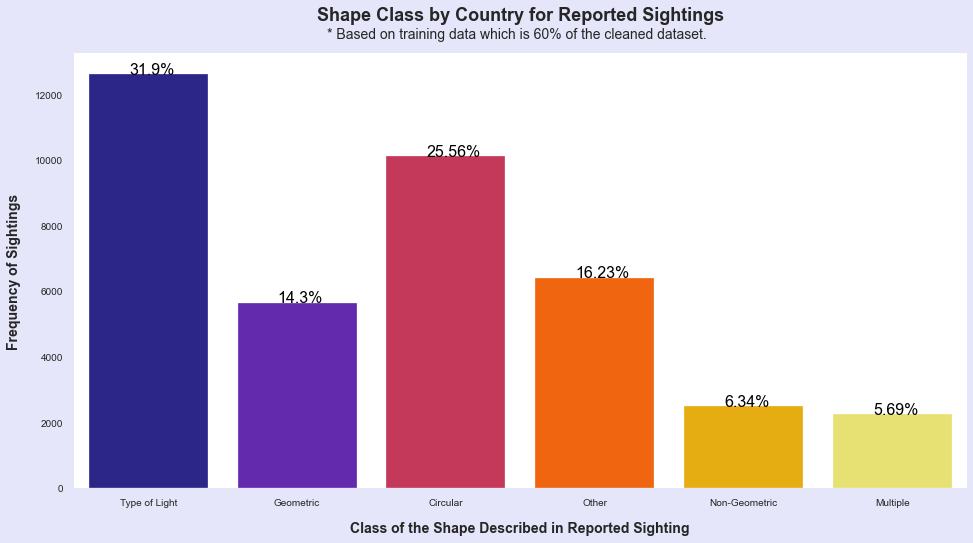

In [53]:
# Plot the frequency of my shape classes:
plt.figure(figsize=(16, 8), facecolor='lavender')
ax = sns.countplot(x='shape_class', data=train, orient='h', palette='CMRmap', saturation=1)
# ax = train[['shape_class', 'country']].value_counts().plot(kind='bar', )
ax.set_title(label=f'Shape Class by Country for Reported Sightings\n', 
             fontdict={'fontsize':18, 'fontweight':'bold'}, loc='center', pad=12)
ax.text(s='* Based on training data which is 60% of the cleaned dataset.', fontsize=14, x=1.20, y=13700)
ax.set_ylabel('Frequency of Sightings', labelpad=14, size=14, weight='bold')
ax.set_xlabel('Class of the Shape Described in Reported Sighting', labelpad=14, size=14, weight='bold');

# Create a list to add plt.patches data to:
totals = []

# Find the values and append to totals list:
for v in ax.patches:
    totals.append(v.get_height())

# Get the individual bar labels using the list above:
tot = sum(totals)

# Set individual bar labels using the above list:
for v in ax.patches:
    ax.text(v.get_x()+0.27, v.get_height()+.5, \
           str(round((v.get_height()/tot)*100, 2))+'%', fontsize=16, color='black')

## Create X feature matrices and y target vectors:

In [54]:
# Set my features and target:
target = 'shape_class'
features = train.columns.drop([target])

# Arrange X feature matrices and y target vectors:
X_train = train[features]
y_train = train[target]
X_val = val[features]
y_val = val[target]
X_test = test[features]
y_test = test[target]

# Check my work:
X_train.head()

,Id,year,month,dow,hour,durations_in_secs,city,state,country,latitude,longitude,movement
64892,72120.0,2007.0,8.0,Tue,23.0,7.0,Tooele,UT,USA,40.530833,-112.297500,0.0
70336,78119.0,2013.0,9.0,Fri,23.0,5.0,Ann Arbor,MI,USA,42.270833,-83.726389,0.0
32462,34691.0,2008.0,3.0,Tue,22.0,300.0,Missoula,MT,USA,46.872222,-113.993056,1.0
18756,20315.0,2011.0,12.0,Sat,21.0,900.0,New York (Long Island),NY,USA,40.714167,-74.006389,0.0
65226,72493.0,2012.0,8.0,Wed,11.0,25.0,Poughkeepsie,NY,USA,41.700278,-73.921389,1.0


## Some Visualizations:

In [55]:
# Save my train dataset to csv to upload to plotly for graphs:
train.to_csv('UFO_train.csv', index=False)

In [56]:
# Create a function in order to run plotly graphs:
def enable_plotly_in_cell():
    display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
    init_notebook_mode(connected=False)
# Need to run this function in each cell that I want to run plotly in.

In [57]:
# Look at a scatter plot between year, state, and shape:
hover = train[['country', 'year', 'month', 'dow', 'hour', 'city']]
fig_scat = px.scatter(train, x='durations_in_secs', y='year', color='shape_class', opacity=.5, hover_data=hover, 
                 labels={'year':'Year of Sighting', 'state':'State', 'shape_class':'Shape Class', 'country':'Country', 
                         'month':'Month', 'dow':'Day of the Week', 'hour':'Hour (24 hr clock)', 'city':'City', 
                         'durations_in_secs':'Duration (seconds) of Sighting'}, trendline='ols', 
                 title='Interactive Scattter Plot of Data Regarding Reported UFO Sighting from 1994 to 2014 in North America')
fig_scat.show()

In [58]:
# Compare country and year by shape_class:
fig_vio = px.violin(train, x='dow', y='year', color='shape_class', hover_data=hover, 
                    labels={'year':'Year', 'state':'State', 'shape_class':'Shape Class', 'country':'Country', 'month':'Month', 
                         'dow':'Day of the Week', 'hour':'Hour (24 hr clock)', 'city':'City'}, 
                    title='Interactive Violin Plot of Data Regarding Reported UFO Sighting from 1994 to 2014 in North America')
fig_vio.show()

In [59]:
# Map latitude and longitude:
fig_map = px.scatter_mapbox(train, lat='latitude', lon='longitude', color='shape_class', 
                        hover_data=train.columns, opacity=0.65, zoom=2)
fig_map.update_layout(mapbox_style='open-street-map', title='Shape Classes by Latitude and Longitude')
fig_map.show()

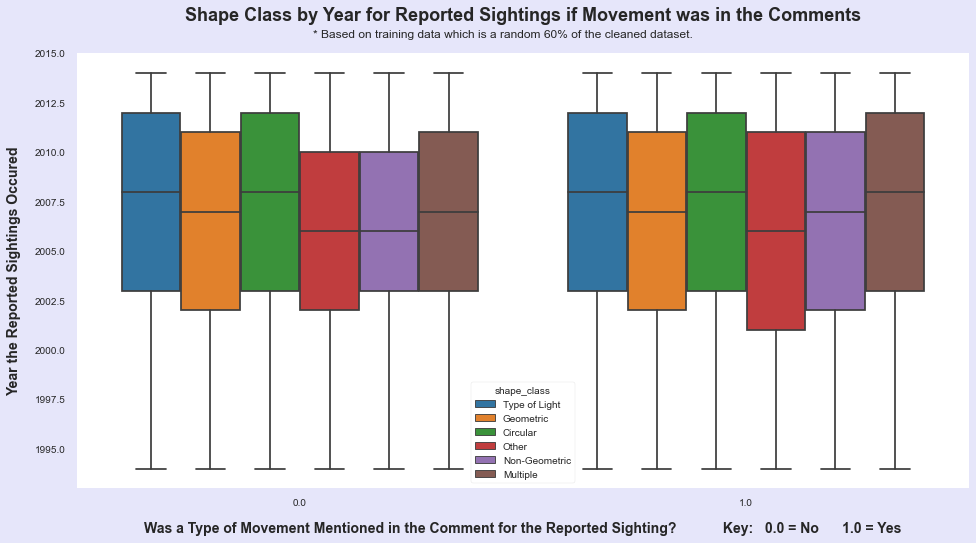

In [60]:
# Look at movement, year and shape:
fig, ax = plt.subplots(figsize=(16, 8), facecolor='lavender')
sns.boxplot(x='movement', y='year', hue='shape_class', data=train)
ax.set_title(label=f'Shape Class by Year for Reported Sightings if Movement was in the Comments\n', 
             fontdict={'fontsize':18, 'fontweight':'bold'}, loc='center', pad=12)
ax.text(s='* Based on training data which is a random 60% of the cleaned dataset.', fontsize=12, x=0.03, y=2015.8)
ax.set_ylabel('Year the Reported Sightings Occured', labelpad=14, size=14, weight='bold')
ax.set_xlabel(f'Was a Type of Movement Mentioned in the Comment for the Reported Sighting?            Key:   0.0 = No      1.0 = Yes', 
              labelpad=14, size=14, weight='bold');

## Logistic Regression:

In [61]:
# Make pipeline for logistic regression:
log_pipe = make_pipeline(ce.OrdinalEncoder(),
                        SimpleImputer(),
                        StandardScaler(),
                        LogisticRegression(random_state=97, n_jobs=-1, C=10.0, solver='newton-cg'))

# Fit on train, score on train and validate:
log_pipe.fit(X_train, y_train)
t_score = log_pipe.score(X_train, y_train)
v_score = log_pipe.score(X_val, y_val)

# Predict on test:
y_pred = log_pipe.predict(X_test)

# Look at the accuracy scores:
print ('Train Accuracy Score =', t_score)
print ('Validate Accuracy Score =', v_score)
print ('Difference between Train and Validate Score =', t_score - v_score)
print ('Test Accuracy =', accuracy_score(y_test, y_pred))

Train Accuracy Score = 0.31782573536844233
Validate Accuracy Score = 0.31587991509147884
Difference between Train and Validate Score = 0.0019458202769634947
Test Accuracy = 0.3186706557774723


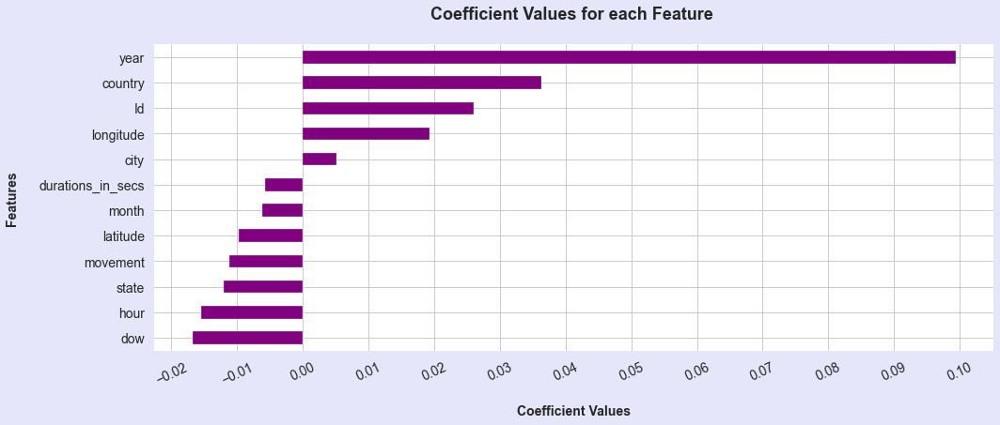

In [62]:
# Pull out elements from the pipeline:
model_lr = log_pipe.named_steps['logisticregression']
encoder_lr = log_pipe.named_steps['ordinalencoder']
encoded_lr = encoder_lr.transform(X_train).columns
coeffs = pd.Series(model_lr.coef_[0], encoded_lr)

# Plot the coefficients of my features:
plt.figure(figsize=(16, 6), facecolor='lavender')
coeffs.sort_values().plot.barh(color='purple')
plt.title(f'Coefficient Values for each Feature \n', size=18, weight='bold')
plt.xlabel(f'\nCoefficient Values', size=14, weight='bold')
plt.ylabel(f'Features \n', size=14, weight='bold')
plt.xticks(ticks=np.arange(-0.02, 0.11, step=0.01), size=14, rotation=25)
plt.yticks(size=14)
plt.grid(axis='both');

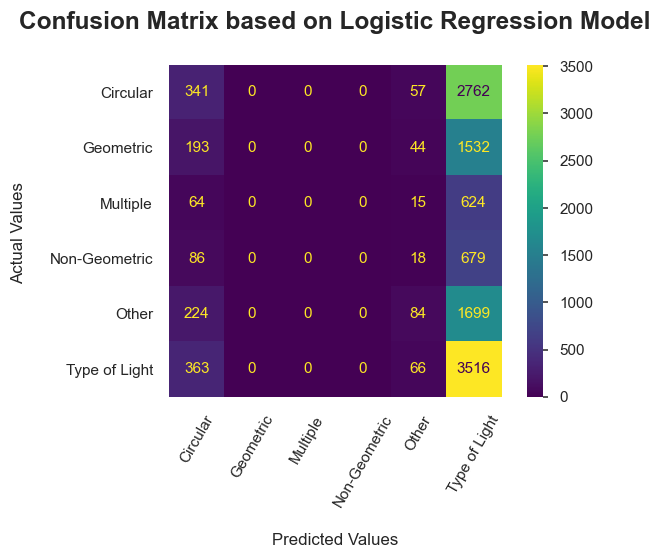

In [63]:
# Increase DPI to see the confussion matrix easier:
plt.rcParams['figure.dpi'] = 110

# Plot my confussion matrix:
plot_confusion_matrix(log_pipe, X_test, y_test, values_format='.0f', xticks_rotation=60)
plt.title(f'Confusion Matrix based on Logistic Regression Model\n', size=16, weight='bold')
plt.ylabel(f'Actual Values \n')
plt.xlabel(f'\nPredicted Values');

In [64]:
# Look at the classification report:
print(classification_report(y_test, y_pred))

               precision    recall  f1-score   support

     Circular       0.27      0.11      0.15      3160
    Geometric       0.00      0.00      0.00      1769
     Multiple       0.00      0.00      0.00       703
Non-Geometric       0.00      0.00      0.00       783
        Other       0.30      0.04      0.07      2007
Type of Light       0.33      0.89      0.48      3945

     accuracy                           0.32     12367
    macro avg       0.15      0.17      0.12     12367
 weighted avg       0.22      0.32      0.20     12367



In [65]:
# Create a function to turn my classification report into a dataframe:
def classification_report_df(y_test, y_pred):
    report = metrics.classification_report(y_test, y_pred, output_dict=True)
    df_class_report = pd.DataFrame(report).transpose()
    return df_class_report
classification_report_df(y_test, y_pred)

,precision,recall,f1-score,support
Circular,0.268293,0.107911,0.153916,3160.000000
Geometric,0.000000,0.000000,0.000000,1769.000000
Multiple,0.000000,0.000000,0.000000,703.000000
Non-Geometric,0.000000,0.000000,0.000000,783.000000
Other,0.295775,0.041854,0.073330,2007.000000
Type of Light,0.325194,0.891255,0.476520,3945.000000
accuracy,0.318671,0.318671,0.318671,0.318671
macro avg,0.148210,0.173503,0.117294,12367.000000
weighted avg,0.220289,0.318671,0.203236,12367.000000


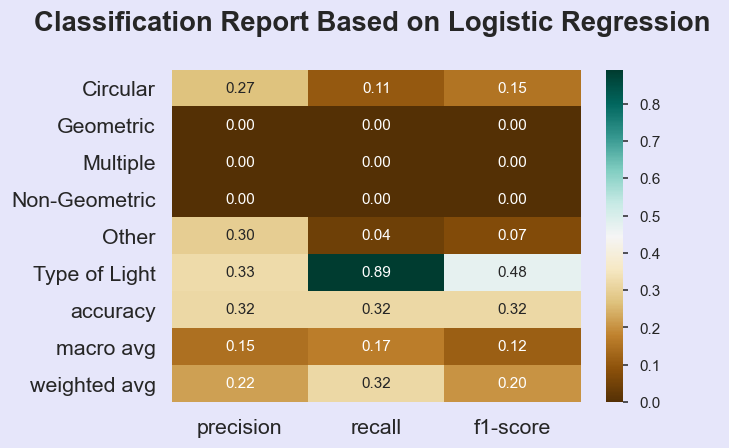

In [66]:
# Create a heatmap to show classification report:
plt.figure(facecolor='lavender')
sns.heatmap(classification_report_df(y_test, y_pred).iloc[:, :-1], annot=True, fmt='.2f', cmap='BrBG')
plt.title(f'Classification Report Based on Logistic Regression \n', size=18, weight='bold')
plt.yticks(fontsize=14)
plt.xticks(fontsize=14);

## Random Forest:

In [67]:
# Make a pipeline for random forest:
rf_pipe = make_pipeline(ce.OrdinalEncoder(),
                       SimpleImputer(),
                       RandomForestClassifier(random_state=97, min_samples_leaf=49, max_depth=18, 
                                             n_estimators=52, max_features='auto'))

# Fit on train, score on train and validation:
rf_pipe.fit(X_train, y_train)
tr_score = rf_pipe.score(X_train, y_train)
vr_score = rf_pipe.score(X_val, y_val)

# Predict on test:
y_pred_r = rf_pipe.predict(X_test)

# Look at the accuracy scores:
print ('Train Accuracy Score =', tr_score)
print ('Validate Accuracy Score =', vr_score)
print ('Difference between Train and Validate Score =', tr_score - vr_score)
print ('Test Accuracy Score =', accuracy_score(y_test, y_pred_r))

Train Accuracy Score = 0.3864095825331042
Validate Accuracy Score = 0.3686444961083594
Difference between Train and Validate Score = 0.01776508642474478
Test Accuracy Score = 0.3624161073825503


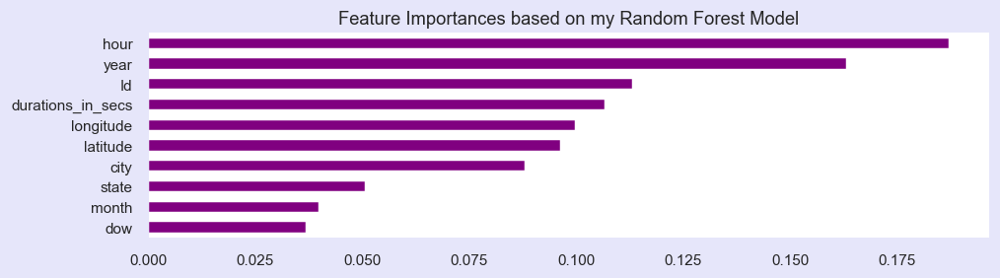

In [68]:
# Pull elements out of the pipeline to get feature importance:
encoder_rf = rf_pipe.named_steps['ordinalencoder']
encoded_rf = encoder_rf.transform(X_train)
rf = rf_pipe.named_steps['randomforestclassifier']

# Define a series for the feature importances:
feat_imp_rf = pd.Series(rf.feature_importances_, encoded_rf.columns)

# Plot the top n features:
n = 10
plt.figure(figsize=(10, n/4), facecolor='lavender')
feat_imp_rf.sort_values()[-n:].plot.barh(color='purple')
plt.title('Feature Importances based on my Random Forest Model');

## XGBoost:

In [69]:
# Encode for XGBoost:
encoder = ce.OrdinalEncoder()
txg_encoded = encoder.fit_transform(X_train)
vxg_encoded = encoder.transform(X_val)

# Set up model:
xg_model = XGBClassifier(n_estimators=118, 
                        max_depth=79, 
                        learning_rate=0.5,
                        n_jobs=-1)

# Set up evalulation set:
eval_set = [(txg_encoded, y_train), (vxg_encoded, y_val)]

# Fit the model:
xg_model.fit(txg_encoded, y_train, eval_set=eval_set, eval_metric='merror', early_stopping_rounds=10)

[0]	validation_0-merror:0.17747	validation_1-merror:0.72142
Multiple eval metrics have been passed: 'validation_1-merror' will be used for early stopping.

Will train until validation_1-merror hasn't improved in 10 rounds.
[1]	validation_0-merror:0.05345	validation_1-merror:0.71657
[2]	validation_0-merror:0.01349	validation_1-merror:0.70353
[3]	validation_0-merror:0.00341	validation_1-merror:0.70080
[4]	validation_0-merror:0.00099	validation_1-merror:0.69605
[5]	validation_0-merror:0.00046	validation_1-merror:0.68948
[6]	validation_0-merror:0.00025	validation_1-merror:0.68574
[7]	validation_0-merror:0.00013	validation_1-merror:0.68432
[8]	validation_0-merror:0.00000	validation_1-merror:0.68190
[9]	validation_0-merror:0.00000	validation_1-merror:0.67826
[10]	validation_0-merror:0.00000	validation_1-merror:0.67512
[11]	validation_0-merror:0.00000	validation_1-merror:0.67795
[12]	validation_0-merror:0.00000	validation_1-merror:0.67704
[13]	validation_0-merror:0.00000	validation_1-merror:0

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.5, max_delta_step=0, max_depth=79,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=118, n_jobs=-1, num_parallel_tree=1,
              objective='multi:softprob', random_state=0, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

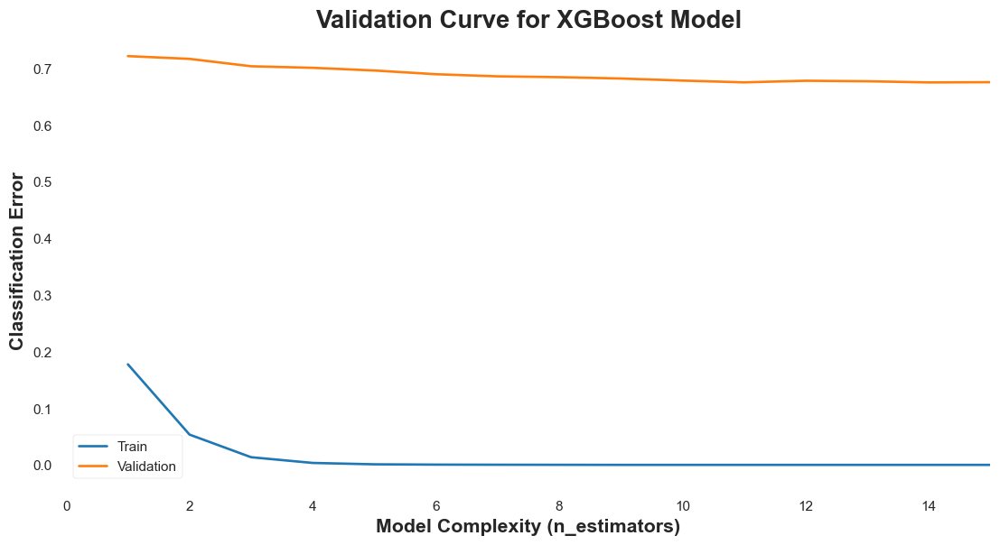

In [70]:
# Plot the validation curve from the results of my model:
results = xg_model.evals_result()
txg_err = results['validation_0']['merror']
vxg_err = results['validation_1']['merror']
epoch = list(range(1, len(txg_err) + 1))
plt.figure(figsize=(12, 6), facecolor='white')
plt.plot(epoch, txg_err, label='Train')
plt.plot(epoch, vxg_err, label='Validation')
plt.ylabel('Classification Error', size=14, weight='bold')
plt.xlabel('Model Complexity (n_estimators)', size=14, weight='bold')
plt.xlim(0, 15)
plt.title('Validation Curve for XGBoost Model', size=18, weight='bold')
plt.legend();

## Permutation Feature Importances:

In [71]:
# Build pipeline for transformers:
trans = make_pipeline(ce.OrdinalEncoder(),
                     SimpleImputer())

# Fit / transform tranformers:
t_tran = trans.fit_transform(X_train)
v_tran = trans.transform(X_val)

# Set up model:
mod = RandomForestClassifier(random_state=97, min_samples_leaf=33, max_depth=None, 
                                             n_estimators=4, max_features='auto')
mod.fit(t_tran, y_train)

# Set up the permuter:
permuter = PermutationImportance(mod, scoring='accuracy', n_iter=10, random_state=97)

# Fit the permuter:
permuter.fit(v_tran, y_val)

PermutationImportance(estimator=RandomForestClassifier(min_samples_leaf=33,
                                                       n_estimators=4,
                                                       random_state=97),
                      n_iter=10, random_state=97, scoring='accuracy')

In [72]:
# Create variable with feature names:
names = X_val.columns.tolist()

# Turn the results into a Series:
pd.Series(permuter.feature_importances_, names).sort_values(ascending=False)

hour                 0.030688
year                 0.014940
durations_in_secs    0.006409
state                0.003528
dow                  0.001476
Id                   0.001365
country             -0.000020
movement            -0.000152
longitude           -0.000526
latitude            -0.000556
month               -0.003477
city                -0.004528
dtype: float64

In [73]:
# Display importances:
eli5.show_weights(permuter, top=None, feature_names=names)

Weight,Feature
0.0307 ± 0.0062,hour
0.0149 ± 0.0032,year
0.0064 ± 0.0058,durations_in_secs
0.0035 ± 0.0020,state
0.0015 ± 0.0034,dow
0.0014 ± 0.0044,Id
-0.0000 ± 0.0002,country
-0.0002 ± 0.0022,movement
-0.0005 ± 0.0045,longitude
-0.0006 ± 0.0044,latitude


## PDP:

In [74]:
# Rearrange my features based on permutation importances above 0:
features = ['hour', 'year', 'durations_in_secs', 'Id', 'longitude', 'month', 'movement', 'city', 'dow', 'state']
X_train = train[features]
X_val = val[features]
X_test = test[features]

# Encode for XGBoost:
encoder = ce.OrdinalEncoder()
txg_encoded = encoder.fit_transform(X_train)
vxg_encoded = encoder.transform(X_val)
test_encoded = encoder.transform(X_test)

# Impute:
imputer = SimpleImputer(strategy='median')
txg_imp = imputer.fit_transform(txg_encoded)
vxg_imp = imputer.transform(vxg_encoded)
test_imp = imputer.transform(test_encoded)

# Need to turn encoded and imputed into a pandas dataframe:
txg_trans = pd.DataFrame(txg_imp, columns=X_train.columns)
vxg_trans = pd.DataFrame(vxg_imp, columns=X_val.columns)

# Set up my model:
xg_mod = XGBClassifier(n_estimators=118, max_depth=79, learning_rate=0.5, n_jobs=-1)

# Set up my evaluation set:
eval_set = [(txg_trans, y_train), (vxg_trans, y_val)]

# Fit my model:
xg_mod.fit(txg_trans, y_train, eval_set=eval_set, eval_metric='merror', early_stopping_rounds=10)

[0]	validation_0-merror:0.19115	validation_1-merror:0.72182
Multiple eval metrics have been passed: 'validation_1-merror' will be used for early stopping.

Will train until validation_1-merror hasn't improved in 10 rounds.
[1]	validation_0-merror:0.05832	validation_1-merror:0.71131
[2]	validation_0-merror:0.01638	validation_1-merror:0.69787
[3]	validation_0-merror:0.00452	validation_1-merror:0.69534
[4]	validation_0-merror:0.00147	validation_1-merror:0.68907
[5]	validation_0-merror:0.00046	validation_1-merror:0.68614
[6]	validation_0-merror:0.00020	validation_1-merror:0.68271
[7]	validation_0-merror:0.00010	validation_1-merror:0.68271
[8]	validation_0-merror:0.00003	validation_1-merror:0.68291
[9]	validation_0-merror:0.00003	validation_1-merror:0.67957
[10]	validation_0-merror:0.00000	validation_1-merror:0.67998
[11]	validation_0-merror:0.00000	validation_1-merror:0.67876
[12]	validation_0-merror:0.00000	validation_1-merror:0.67947
[13]	validation_0-merror:0.00000	validation_1-merror:0

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.5, max_delta_step=0, max_depth=79,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=118, n_jobs=-1, num_parallel_tree=1,
              objective='multi:softprob', random_state=0, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

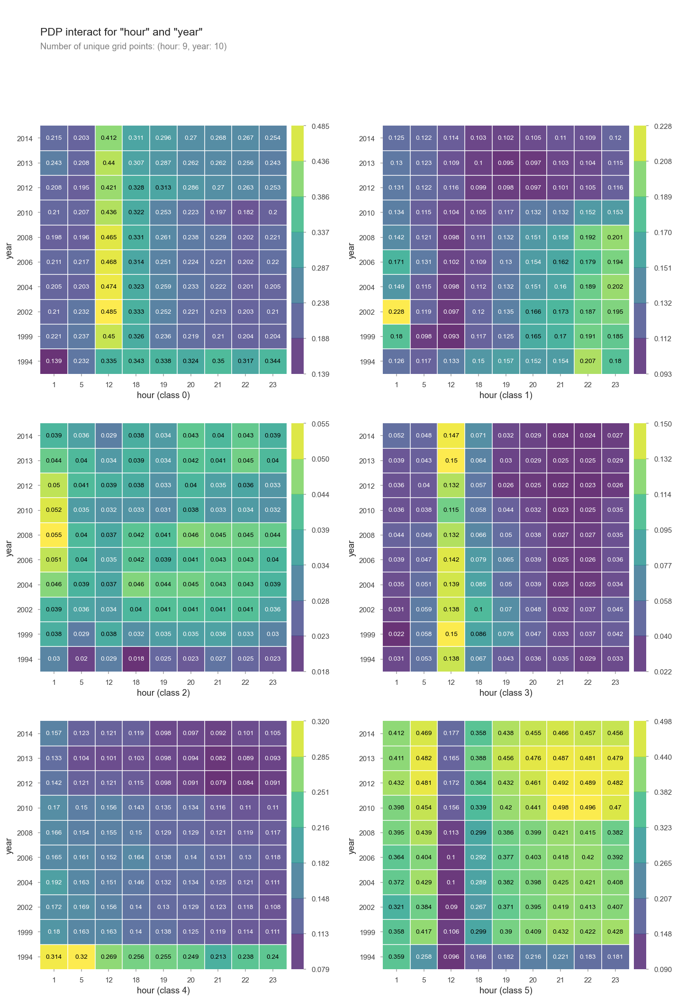

In [75]:
# Define features for the plot:
feats1 = ['hour', 'year']

# Set my perameters for the plot:
inter1 = pdp_interact(model=xg_mod, dataset=vxg_trans, features=feats1, 
                   model_features=X_val.columns)

# Create the plot:
pdp_interact_plot(inter1, plot_type='grid', feature_names=feats1);